Shape of the new dataframe: (120217, 32)
First 5 rows of the new dataframe:
   Airbnb Property ID  superhost_period_all  host_is_superhost_in_period  \
0              1947.0                  13.0                          0.0   
1              1947.0                  15.0                          0.0   
2              1947.0                  18.0                          1.0   
3              1947.0                  19.0                          0.0   
4              1947.0                  20.0                          0.0   

   numCancel_pastYear  prop_5_StarReviews_pastYear  numReserv_pastYear  \
0                 0.0                     1.000000                 5.0   
1                 1.0                     1.000000                21.0   
2                 0.0                     0.733333                32.0   
3                 0.0                     0.687500                34.0   
4                 0.0                     0.769231                44.0   

   hostResponseAverage

C:\Users\PC\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


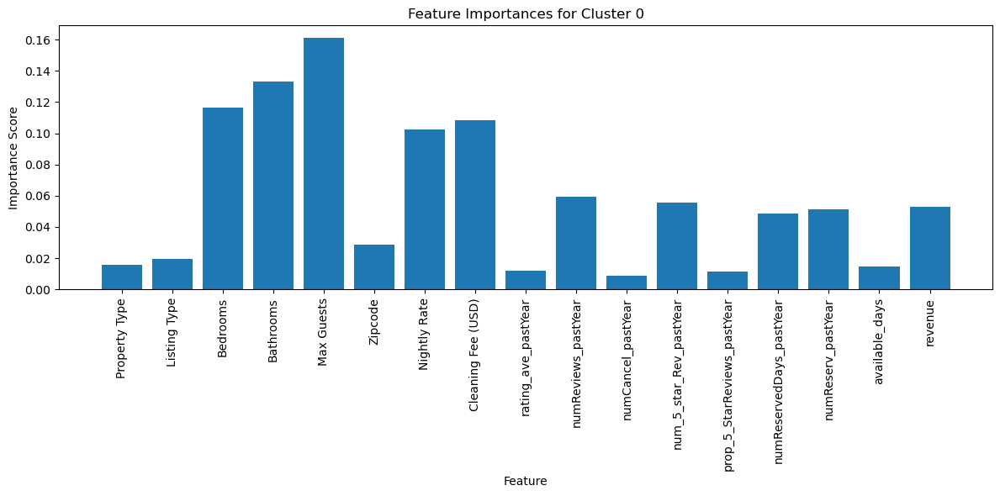

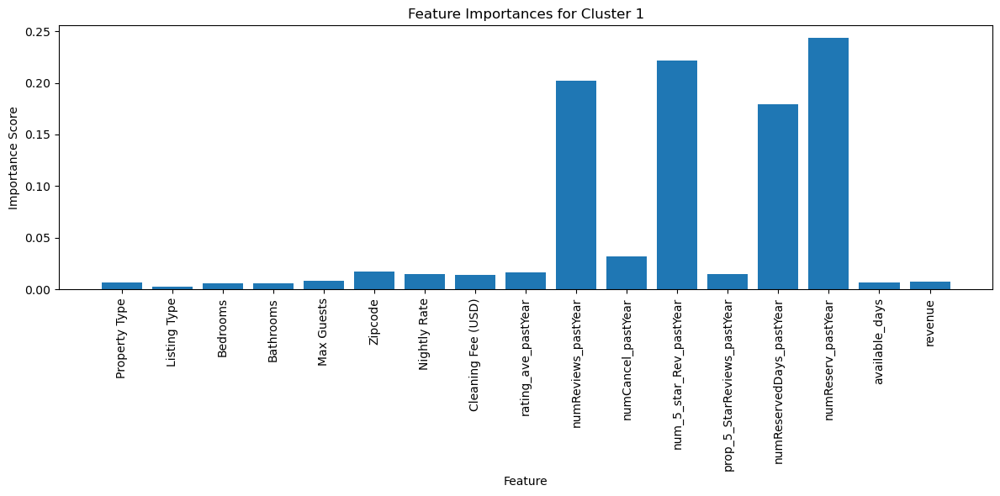

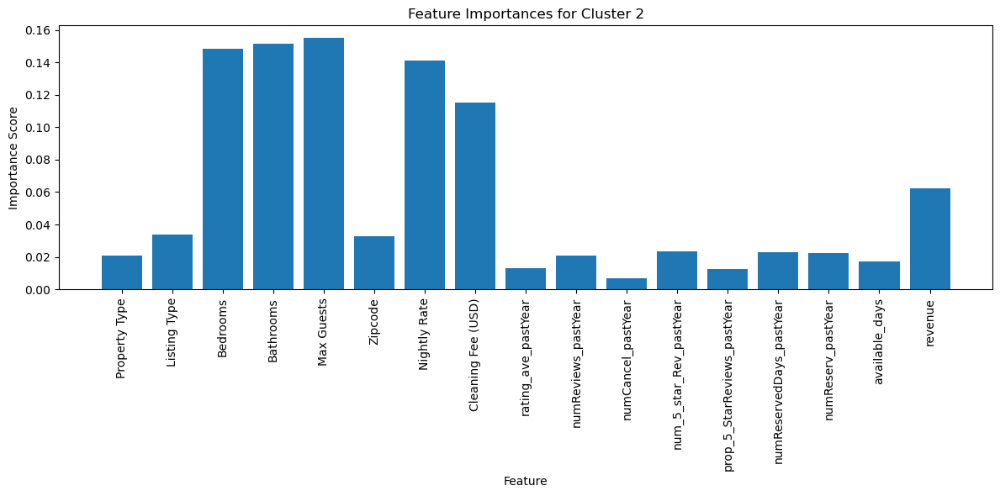

In [6]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import numpy as np


# Load the data from the CSV file
df = pd.read_csv('C:\\Users\\PC\\Desktop\\IT Innovation\\project\\data\\airbnb_Chicago.csv')

# These columns are chosen for their relevance to Airbnb property analysis
selected_columns = [
    'Airbnb Property ID', 'superhost_period_all', 'host_is_superhost_in_period', 'numCancel_pastYear',
    'prop_5_StarReviews_pastYear', 'numReserv_pastYear', 'hostResponseAverage_pastYear', 'Pets Allowed',
    'Property Type', 'Bedrooms', 'Bathrooms', 'Cleaning Fee (USD)', 'Rating Overall', 'occupancy_rate',
    'zip_total_population', 'zip_hispanic_or_latino_anyrace_percent', 'Number of Reviews',
    'zip_white_nothispanic_percent', 'zip_black_nothispanic_percent', 'zip_asian_nothispanic_percent',
    'rating_ave_pastYear', 'numReviews_pastYear', 'numReservedDays_pastYear', 'prev_revenue', 
    'prev_occupancy_rate', 'tract_prev_superhosts', 'tract_prev_superhosts_ratio', 'prev_Rating Overall', 
    'prev_Number of Reviews', 'prev_Nightly Rate','Latitude','Longitude'
]


# Create a new dataframe with selected columns
data = df[selected_columns]

# Display the shape of the new dataframe (number of rows and columns)
print("Shape of the new dataframe:", data.shape)

# Display the first few rows of the new dataframe
print("First 5 rows of the new dataframe:")
print(data.head()) 
# Replace with your actual file path
data = pd.read_csv('C:\\Users\\PC\\Desktop\\IT Innovation\\project\\data\\airbnb_Chicago.csv')

# Define the features for which you want to drop rows with empty or null values
features_to_check = [
    'Property Type', 'Listing Type', 'Bedrooms',
    'Bathrooms', 'Max Guests', 'Zipcode',
    'Nightly Rate', 'Cleaning Fee (USD)',
    'rating_ave_pastYear', 'numReviews_pastYear', 'numCancel_pastYear',
    'num_5_star_Rev_pastYear', 'prop_5_StarReviews_pastYear',
    'numReservedDays_pastYear', 'numReserv_pastYear', 'available_days',
    'revenue'
]

# Drop rows with any null values in the specified features
data.dropna(subset=features_to_check, inplace=True)

# Define the features to be used
features = [
    'Property Type', 'Listing Type', 'Bedrooms',
    'Bathrooms', 'Max Guests', 'Zipcode',
    'Nightly Rate', 'Cleaning Fee (USD)',
    'rating_ave_pastYear', 'numReviews_pastYear', 'numCancel_pastYear',
    'num_5_star_Rev_pastYear', 'prop_5_StarReviews_pastYear',
    'numReservedDays_pastYear', 'numReserv_pastYear', 'available_days',
    'revenue'
]

# Identify numerical and categorical features
categorical_features = ['Property Type', 'Listing Type', 'Zipcode']
numerical_features = [f for f in features if f not in categorical_features]

# Impute missing values and scale numerical features
num_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

# Impute missing values and OneHotEncode categorical features
cat_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Combine preprocessing steps
preprocessor = ColumnTransformer(
    transformers=[
        ('num', num_pipeline, numerical_features),
        ('cat', cat_pipeline, categorical_features)
    ])

# Preprocess the data
X = preprocessor.fit_transform(data)

# Perform K-Means clustering with n_clusters=3
kmeans = KMeans(n_clusters=3, random_state=0)
data['Cluster'] = kmeans.fit_predict(X)

# Feature importance analysis for each cluster
for cluster in range(3):
    target = (data['Cluster'] == cluster).astype(int)
    rf = RandomForestClassifier(n_estimators=100, random_state=0)
    rf.fit(X, target)

    importances = rf.feature_importances_

    # Get the feature names after OneHotEncoding
    onehot_columns = preprocessor.named_transformers_['cat']['onehot'].get_feature_names_out(categorical_features)
    onehot_importances = dict(zip(onehot_columns, importances[len(numerical_features):]))

    # Aggregate the importances for the one-hot encoded features
    aggregated_importances = {}
    for original_feature in categorical_features:
        aggregated_importances[original_feature] = sum(onehot_importances[name] for name in onehot_columns if name.startswith(original_feature))

    # Combine with the importances for numerical features
    for i, feature in enumerate(numerical_features):
        aggregated_importances[feature] = importances[i]

    # Sort features by importance
    sorted_features = sorted(aggregated_importances.items(), key=lambda item: item[1], reverse=True)

    # Plotting feature importances
    plt.figure(figsize=(12, 6))
    plt.title(f"Feature Importances for Cluster {cluster}")
    plt.bar(range(len(features)), [aggregated_importances[feature] for feature in features], align='center')
    plt.xticks(range(len(features)), features, rotation=90)
    plt.xlabel('Feature')
    plt.ylabel('Importance Score')
    plt.tight_layout()  # Adjust layout to prevent clipping of tick-labels
    plt.show()
    


In [8]:
# Export the final DataFrame to a CSV file
data.to_csv('C:\\Users\\PC\\Desktop\\IT Innovation\\project\\data\\processed_airbnb_Chicago.csv', index=False)


In [12]:
pip install folium


  Obtaining dependency information for folium from https://files.pythonhosted.org/packages/18/09/8569904c8ce5679cc02826d98de633c07abcd2443a23181e5f71ff9dacbc/folium-0.15.1-py2.py3-none-any.whl.metadata
  Obtaining dependency information for branca>=0.6.0 from https://files.pythonhosted.org/packages/2f/e7/603b136221de923055716d23e3047da71f92e0d8ba2c4517ce49a54fe768/branca-0.7.0-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/97.0 kB ? eta -:--:--
   ------------ --------------------------- 30.7/97.0 kB 1.3 MB/s eta 0:00:01
   ------------ --------------------------- 30.7/97.0 kB 1.3 MB/s eta 0:00:01
   ---------------- ----------------------- 41.0/97.0 kB 279.3 kB/s eta 0:00:01
   ---------------------------------------- 97.0/97.0 kB 552.9 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [18]:
import folium
import pandas as pd

# Load the dataset into a DataFrame
df = pd.read_csv('C:\\Users\\PC\\Desktop\\IT Innovation\\project\\data\\processed_airbnb_Chicago.csv')

# Initialize the map centered around Chicago
chicago_map = folium.Map(location=[41.8781, -87.6298], zoom_start=11)

# Define colors for each cluster
cluster_colors = {0: 'red', 1: 'yellow', 2: 'blue'}

# Add points to the map
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color=cluster_colors[row['Cluster']],
        fill=True,
        fill_color=cluster_colors[row['Cluster']],
        fill_opacity=0.6
    ).add_to(chicago_map)

# Display the map
chicago_map


In [19]:
chicago_map.save('chicago_clusters.html')
